In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

## This library contains the interact widget that will help with parameter tuning
from IPython.html.widgets import *

/opt/conda/lib/python3.6/site-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated since IPython 4.0. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)


## Calibrate Camera

In [2]:
# Get camera calibration images
import os, glob
camera_cal_img_files = glob.glob("camera_cal/calibration*")

In [3]:
def cal_camera(img, objpoints, imgpoints):
    '''
    Take an image, object points, and image points, calibrate the camera,
    then correct and return an undistorted version of the image.
    
    Returns ret, mtx, dist, rvecs, tvecs
    '''
    return cv2.calibrateCamera(objpoints, imgpoints, img.shape[1:3], None, None)

def undistort_image(img, mtx, dist):
    '''
        Take an image and camera calibration values, undistort the image, and return it.
    '''
    return cv2.undistort(img, mtx, dist, None, mtx)
    
def import_calibration_images():
    # Prepare object points
    nx = 9
    ny = 6
    
    # Get known coordinates of the corners in the image
    objp = np.zeros((ny*nx,3), np.float32)
    
    # Generate x, y-coordinates
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)
    
    for fname in camera_cal_img_files:
        image = mpimg.imread(fname)
        img = np.copy(image)
    
        # Convert image to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
        # Find chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
        
        if ret == True:
            imgpoints.append(corners)
            objpoints.append(objp)
            img = cv2.drawChessboardCorners(img, (nx, ny), corners, ret)

## Image Saving and Display Helpers

In [4]:
def save_images(images, titles, subtitle, directory):
    for i in range(len(images)):
        filename = directory + titles[i][:-4] + "-" + subtitle + ".jpg"
        print(filename)
        mpimg.imsave(filename, images[i])
        
def show_images(images, titles, cmap=None):
    """
    Display all test images for analysis.
    """

    cols = 2
    rows = (len(images)+1)//cols
    
    plt.figure(figsize=(12,12))
    for i, image in enumerate(images):
        plt.subplot(rows, cols, i+1)
        if len(image.shape) != 2:
            cmap='gray'
        plt.imshow(image, cmap=cmap)
        plt.title(titles[i])
    plt.tight_layout(pad=0, h_pad=2, w_pad=2)
    plt.show()
    
def show_images_sxs(left_image, right_image, titles=['Original Image', 'Corrected Image'], left_cmap=None, right_cmap=None):
    """
    Display images side-by-side for analysis.
    """

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(left_image, left_cmap)
    ax1.set_title(titles[0], fontsize=50)
    ax2.imshow(right_image, right_cmap)
    ax2.set_title(titles[1], fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=1.5, bottom=0.)

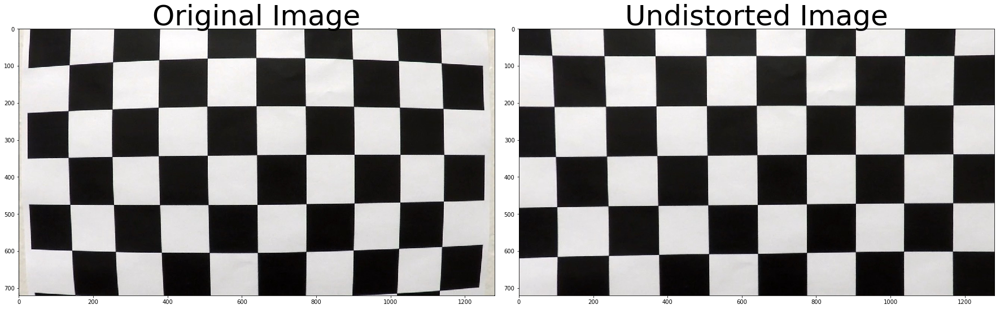

In [5]:
# Define arrays for image points and object points
objpoints = []
imgpoints = []
import_calibration_images()

#Show image before and after camera calibration
img_test = mpimg.imread(camera_cal_img_files[16]) #7, 10, 16
ret, mtx, dist, rvecs, tvecs = cal_camera(img_test, objpoints, imgpoints)
img_undst = undistort_image(img_test, mtx, dist)

#save_images([img_test], ['camera_cal_img.jpg'], 'original', 'output_images/camera_calibration_images/')
#save_images([img_undst], ['camera_cal_img.jpg'], 'undistorted', 'output_images/camera_calibration_images/')
show_images_sxs(img_test, img_undst, ['Original Image', 'Undistorted Image'])

## Undistort test images and save them to the output_images directory

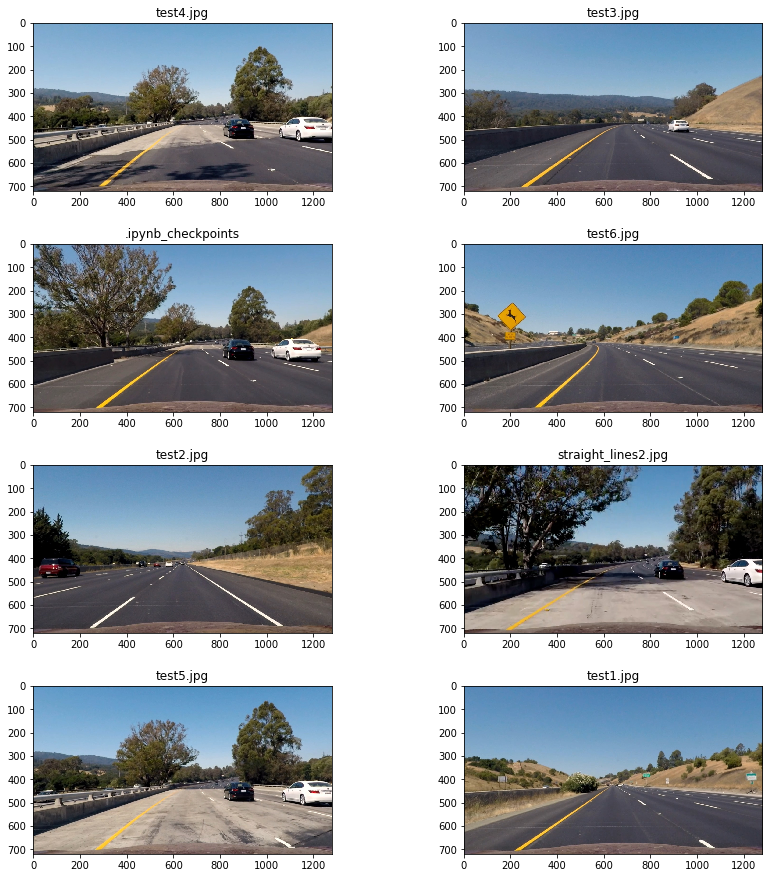

In [6]:
test_images = [plt.imread(path) for path in glob.glob('test_images/*.jpg')]
titles = os.listdir("test_images/")

test_images_undst = [undistort_image(image, mtx, dist) for image in test_images]
#save_images(test_images_undst, titles,'undistorted', 'output_images/undistorted_test_images/')
show_images(test_images_undst, titles)

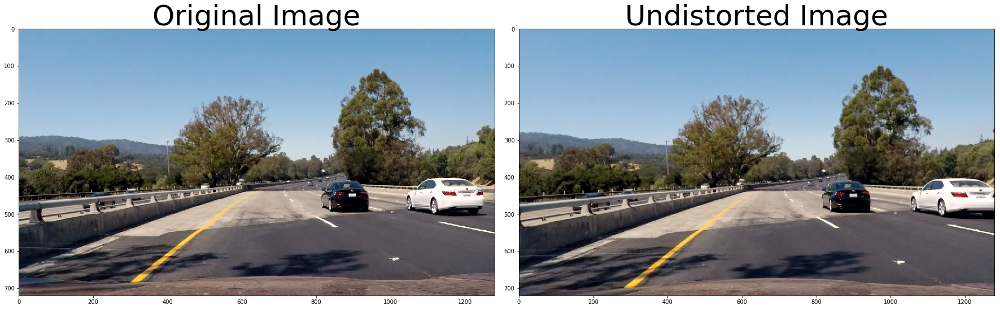

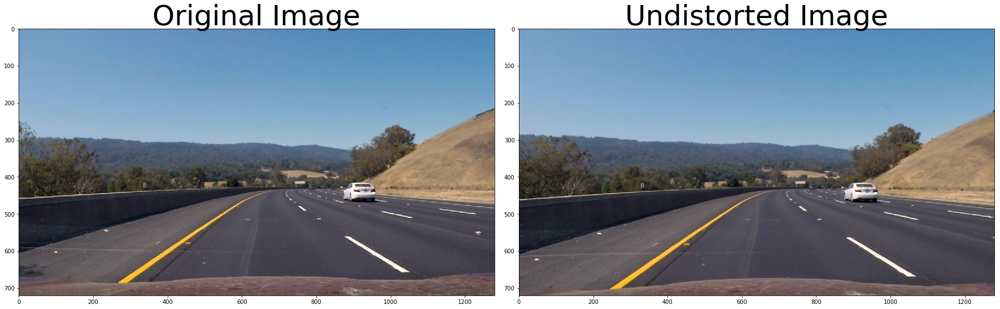

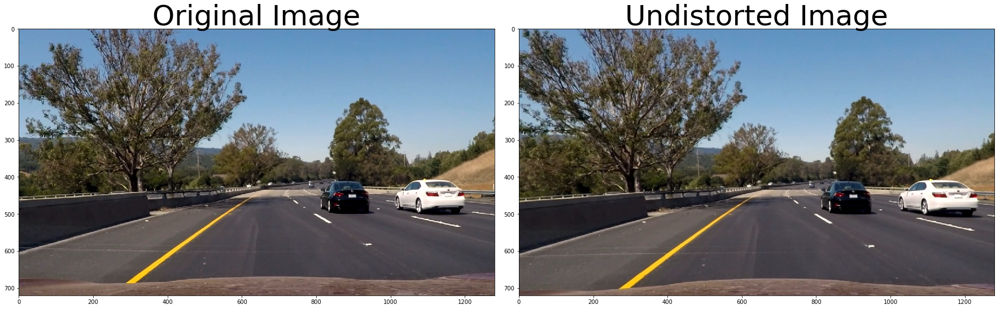

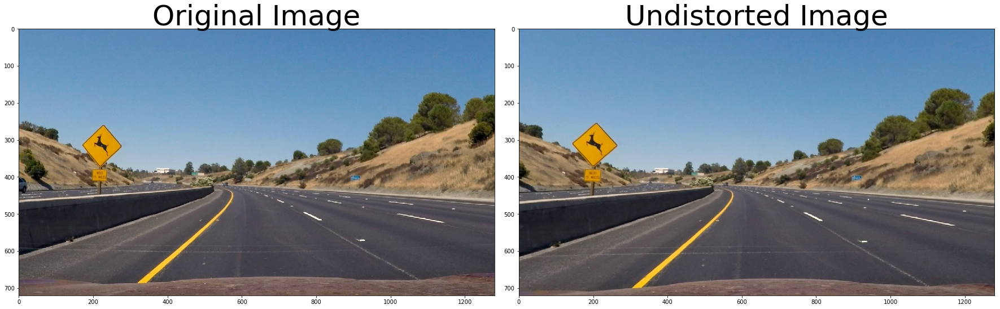

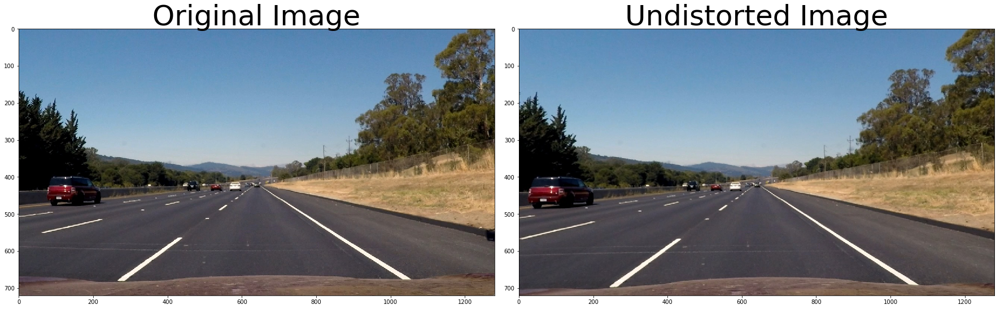

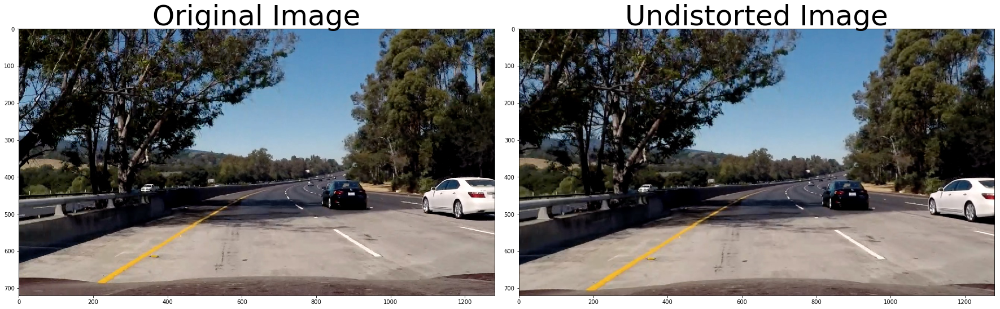

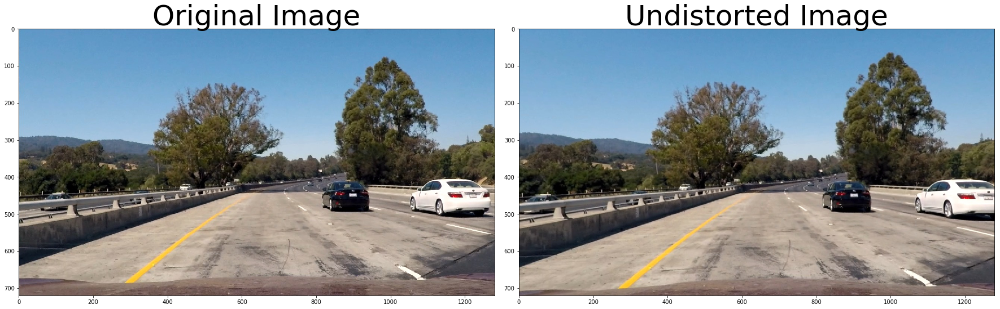

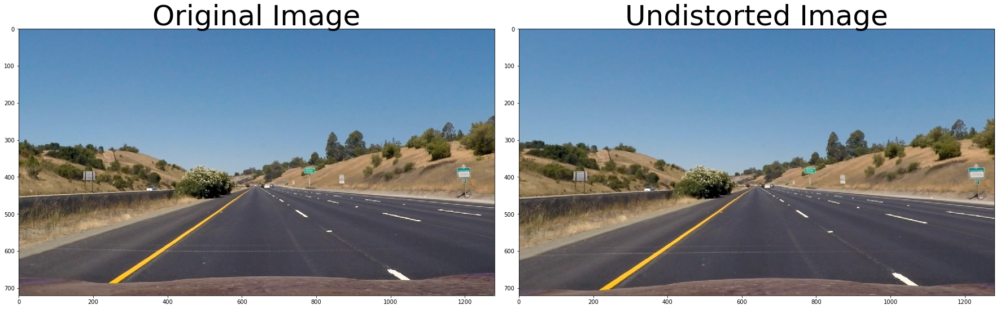

In [7]:
# Show individual undistorted images side-by-side with original for analysis
img_id = 3
for i in range(len(test_images)):
    show_images_sxs(test_images[i], test_images_undst[i], ['Original Image', 'Undistorted Image'])

## Perform Filtering on Calibrated Images

In [8]:
def abs_sobel_thresh(image, orient='x', kernel_size=3, thresh=(0, 255)):
    img = np.copy(image)
    
    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    #Take the derivative in the axis specified by the orient parameter
    if orient=='x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, kernel_size)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, kernel_size)
        
    # Get the absolute value of the derivative
    sobel_abs = np.absolute(sobel)
    
    # Scale absolute value to 8-bits
    sobel_norm = np.uint8(255*sobel_abs/np.max(sobel_abs))
    
    # Create a mask of 1's where the scaled derivative magnitude is between the threshold parameters
    sobel_bin = np.zeros_like(sobel_norm)
    sobel_bin[(sobel_norm >= thresh[0]) & (sobel_norm <= thresh[1])] = 1
    
    return sobel_bin

def mag_thresh(image, kernel_size=3, mag_thresh=(0,255)):
    img = np.copy(image)
    
    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Calculate the derivative in x and y-directions
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel_size)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel_size)
    
    # Calculate the magnitude of the derivative
    sobel_magnitude = np.sqrt(np.square(sobelx) + np.square(sobely))
    
    # Normalize magnitude to 8-bit value
    sobel_magnitude_norm = np.uint8(255 * sobel_magnitude/np.max(sobel_magnitude))
    
    # Create binary mask of values within mag_threshold
    sobel_bin = np.zeros_like(sobel_magnitude_norm)
    sobel_bin[(sobel_magnitude_norm >= mag_thresh[0]) & (sobel_magnitude_norm <= mag_thresh[1])] = 1
    
    # Return the mask
    return sobel_bin

# Implement directional filtering
def dir_threshold(image, kernel_size=3, thresh=(0, np.pi/2)):
    img = np.copy(image)
    
    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Calculate the derivative in x and y-directions
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel_size)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel_size)
    
    # Calculate the absolute value of each derivative
    sobelx_abs = np.absolute(sobelx)
    sobely_abs = np.absolute(sobely)
    
    # Calculate the direction of the gradient
    direction = np.arctan2(sobely_abs, sobelx_abs)
    
    binary_output = np.zeros_like(gray)
    binary_output[(direction >= thresh[0])&(direction <= thresh[1])] = 1
    
    return binary_output


def select_lines_in_hls(image):
    img = np.copy(image)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    
    # Mask for yellow lines
    lower_thresh = np.uint8([10, 0, 100])
    upper_thresh = np.uint8([40, 255, 255])
    yellow_line_mask = cv2.inRange(hls, lower_thresh, upper_thresh)
    
    # Mask for white lines
    lower_thresh = np.uint8([0,180,0])
    upper_thresh = np.uint8([255,255,255])
    white_line_mask = cv2.inRange(hls, lower_thresh, upper_thresh)
    
    # Combine color masks
    cmb_mask = cv2.bitwise_or(yellow_line_mask, white_line_mask)
    return cv2.bitwise_and(img, img, mask = cmb_mask)

# Resource: https://github.com/JustinHeaton/Advanced-Lane-Finding/blob/master/Lane_Finding.ipynb
def select_lines_in_colorspaces(image):
    img = np.copy(image)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2Luv)
    luv = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    
    s = hls[:,:,2]
    s_lower_thresh = 180
    s_upper_thresh = 255
    s_binary = np.zeros_like(s)
    s_binary[(s >= s_lower_thresh) & (s <= s_upper_thresh)] = 1
    
    b = lab[:,:,2]
    b_lower_thresh = 160
    b_upper_thresh = 200
    b_binary = np.zeros_like(b)
    b_binary[(b >= b_lower_thresh) & (b <= b_upper_thresh)] = 1
    
    l = luv[:,:,0]
    l_lower_thresh = 210
    l_upper_thresh = 255
    l_binary = np.zeros_like(l)
    l_binary[(l >= l_lower_thresh) & (l <= l_upper_thresh)] = 1
    
    binary_comb = np.zeros_like(s)
    binary_comb[(l_binary == 1) | (b_binary == 1)] = 1
    
    return binary_comb


# Implement HLS (s-channel) filtering
def apply_saturation_mask(image):
    img = np.copy(image)
    
    s = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)[:,:,2]
    
    thresh = (100, 255)
    binary_output = np.zeros_like(s)
    binary_output[(s >= thresh[0]) & (s <= thresh[1])] = 1

    return binary_output


# Combine color and gradient filtering
def apply_saturation_and_gradient_masks(image):
    img = np.copy(image)
    
    kernel_size = 3
    s = apply_saturation_mask(image)
    dx = abs_sobel_thresh(img, 'x', kernel_size, (20, 100))
    dy = abs_sobel_thresh(img, 'y', kernel_size, (20, 100))
    mag = mag_thresh(img, kernel_size, (30, 100))
    direction = dir_threshold(img, kernel_size, (0.7, 1.3))
    comb = np.zeros_like(direction)    
    #comb[((dx == 1) & (dy == 1)) | ((mag == 1) & (direction == 1)) | (s == 1)] = 1
    comb[((dx == 1) & (dy == 1)) | (s == 1)] = 1
    
    return comb

## Visualize Binary Filtering Results

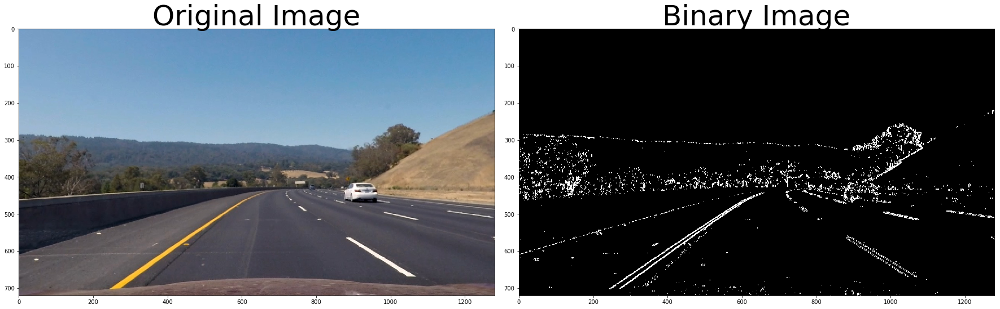

In [9]:
# Convert undistorted test images to binary
binary_test_images = [abs_sobel_thresh(image, 'x', 3, (20, 100)) for image in test_images_undst]

# Show individual binary images side-by-side with original for analysis
img_id = 1
show_images_sxs(test_images_undst[img_id], binary_test_images[img_id], ['Original Image', 'Binary Image'], None, 'gray')

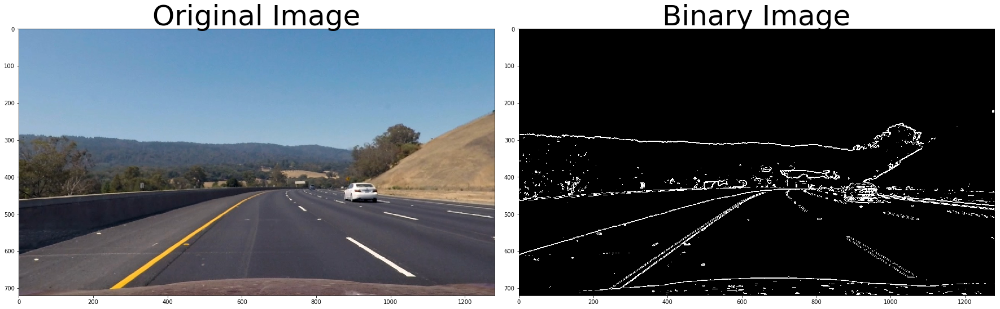

In [10]:
# Visualize Magnitude Filter
binary_test_images2 = [mag_thresh(image, 3, (30, 100)) for image in test_images_undst]
img_id = 1
show_images_sxs(test_images_undst[img_id], binary_test_images2[img_id], ['Original Image', 'Binary Image'], None, 'gray')

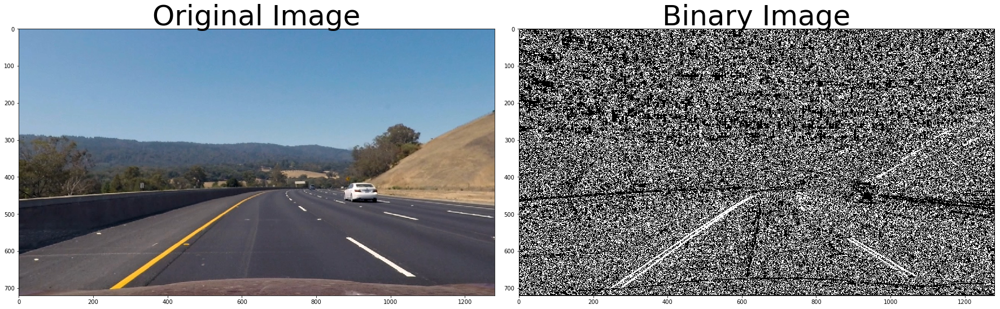

In [11]:
# Visualize directional threshold filter
binary_test_images3 = [dir_threshold(image, 3, (0.7, 1.3)) for image in test_images_undst]
img_id = 1
show_images_sxs(test_images_undst[img_id], binary_test_images3[img_id], ['Original Image', 'Binary Image'], None, 'gray')

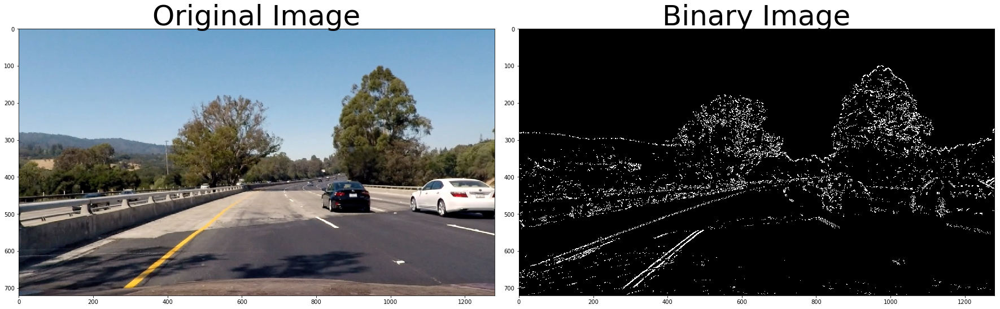

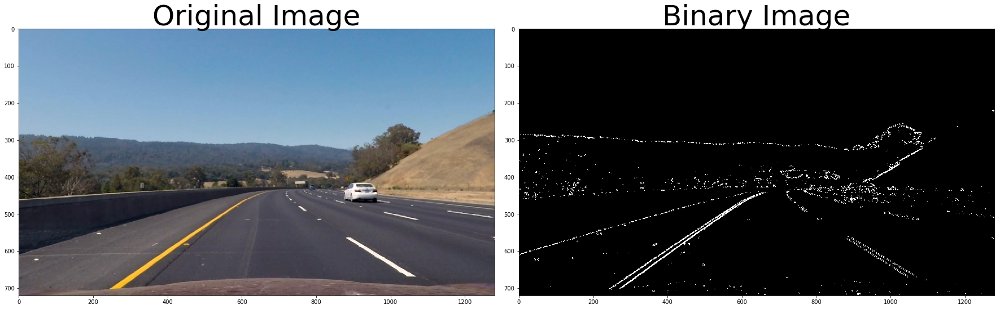

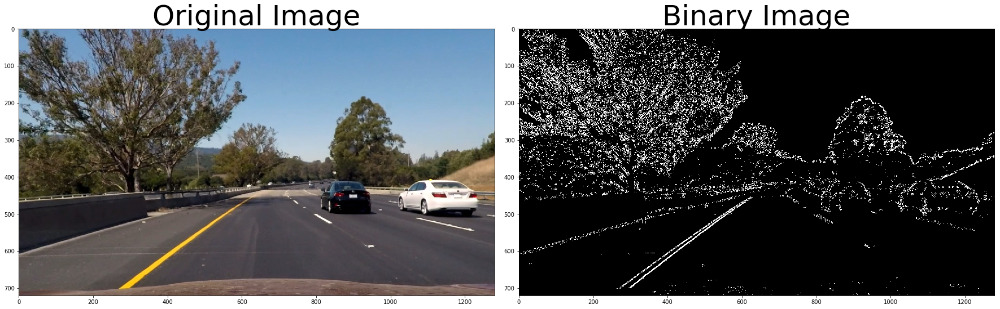

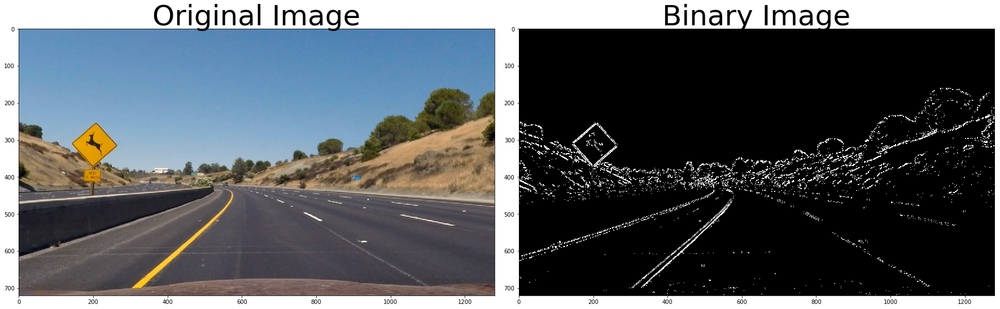

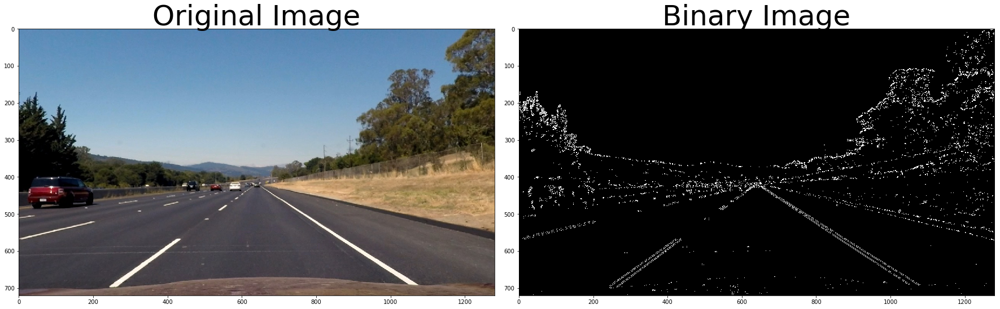

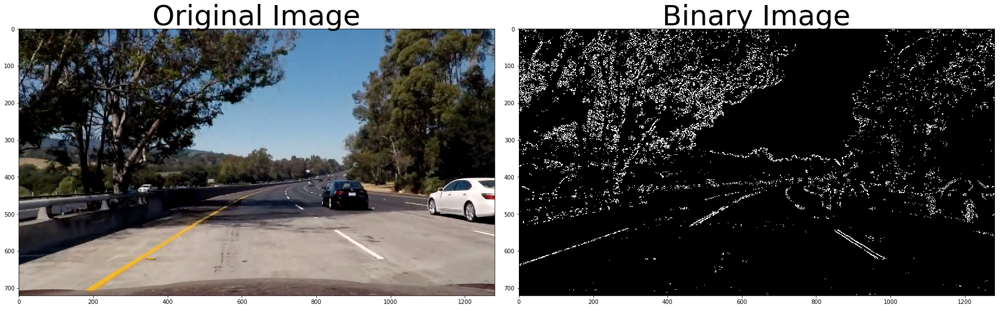

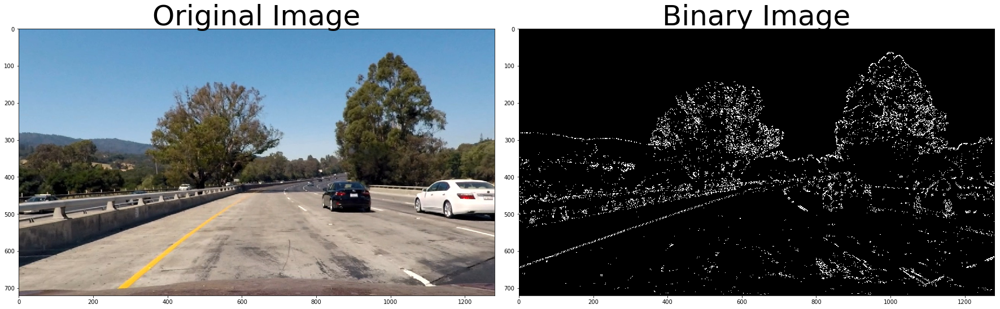

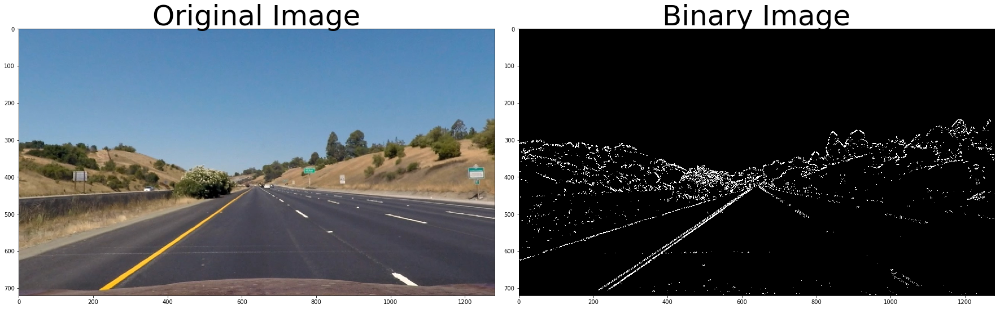

In [12]:
# Visualize filter combinations
kernel_size = 3
for image in test_images_undst:
    img = np.copy(image)
    dx = abs_sobel_thresh(img, 'x', kernel_size, (20, 100))
    dy = abs_sobel_thresh(img, 'y', kernel_size, (20, 100))
    mag = mag_thresh(img, kernel_size, (30, 100))
    direction = dir_threshold(img, kernel_size, (0.7, 1.3))
    comb = np.zeros_like(direction)    
    comb[((dx == 1) & (dy == 1)) | ((mag == 1) & (direction == 1))] = 1
    
    show_images_sxs(image, comb, ['Original Image', 'Binary Image'], None, 'gray')        

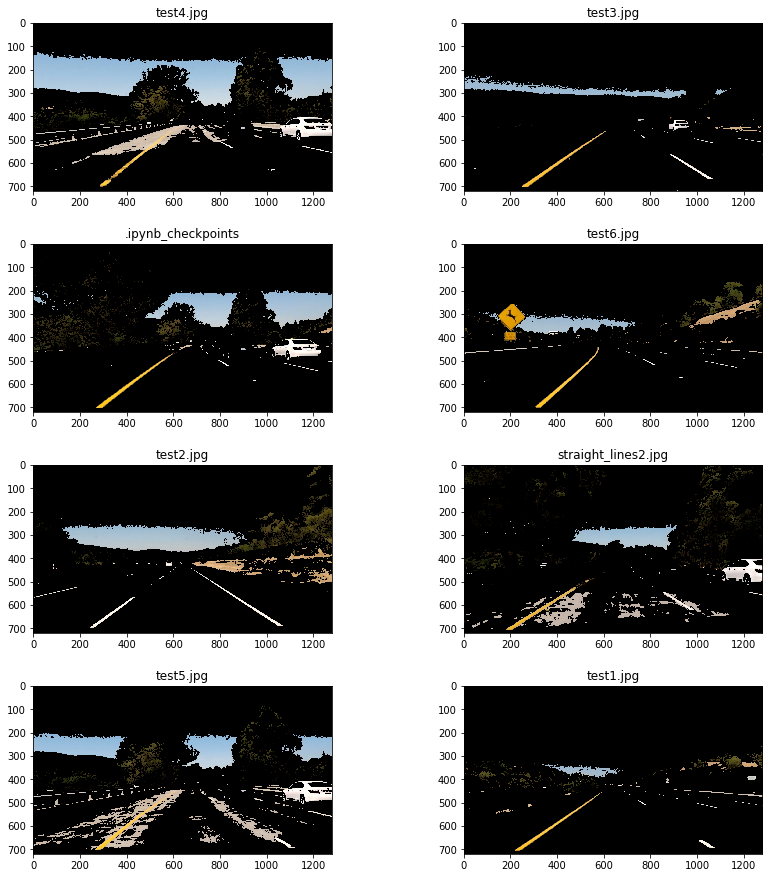

In [13]:
# Display images with HLS colorspace filtering
hls_images = list(map(select_lines_in_hls, test_images_undst))
show_images(hls_images, titles)

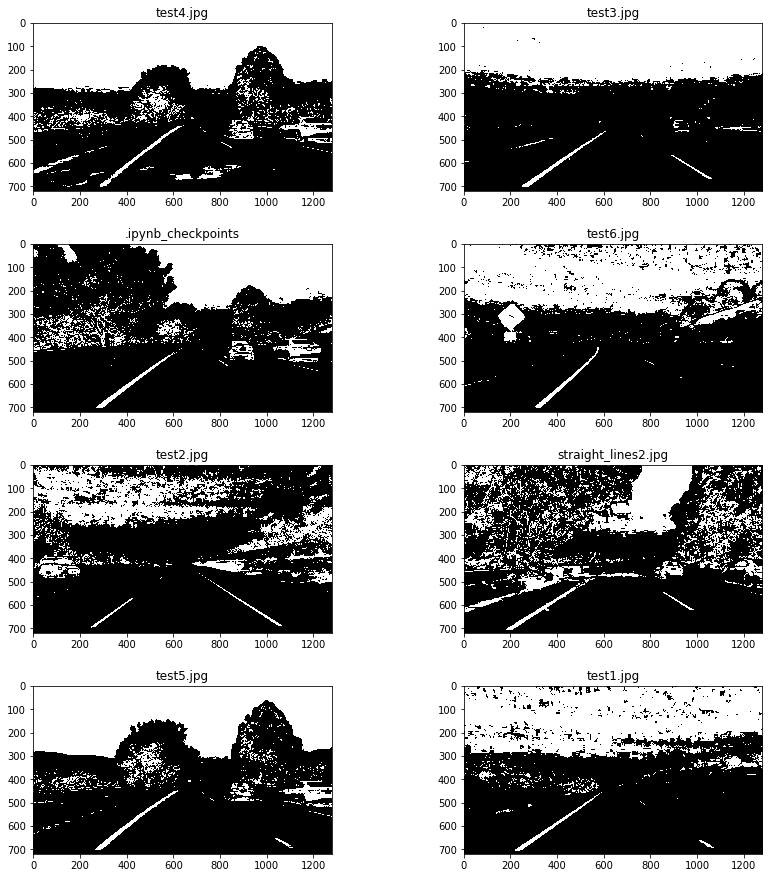

In [14]:
# Implement HLS (s-channel) filtering
saturation_images = list(map(apply_saturation_mask, test_images_undst))
show_images(saturation_images, titles, 'gray')

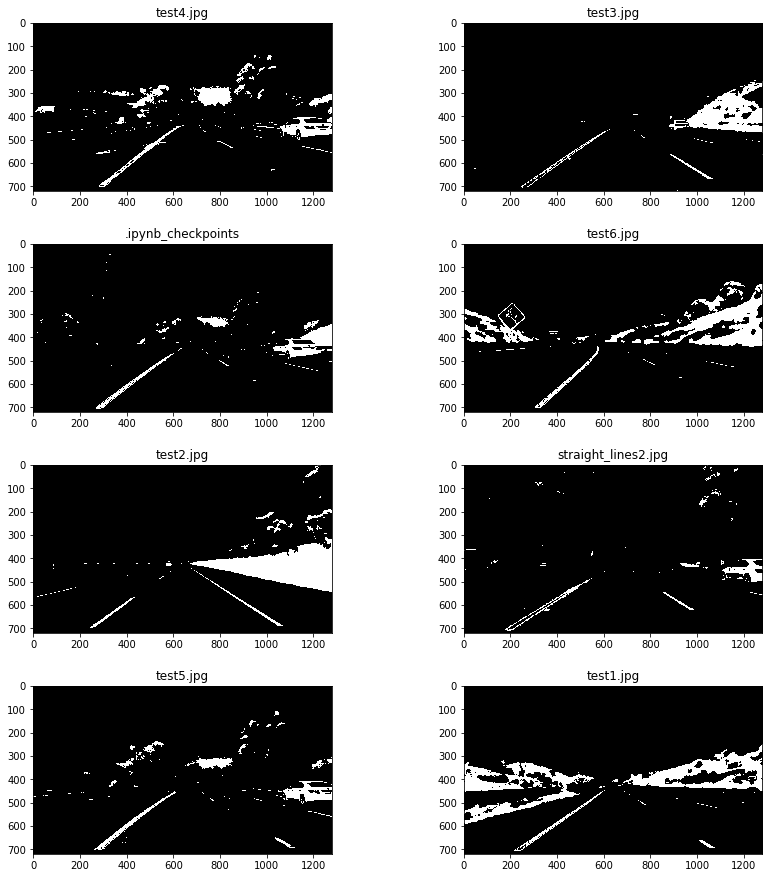

In [15]:
# Implement LAB and LUV colorspace filtering
lab_luv_images = list(map(select_lines_in_colorspaces, test_images_undst))
show_images(lab_luv_images, titles, 'gray')
#save_images(lab_luv_images, titles, 'binary', 'output_images/binary_filtered/')

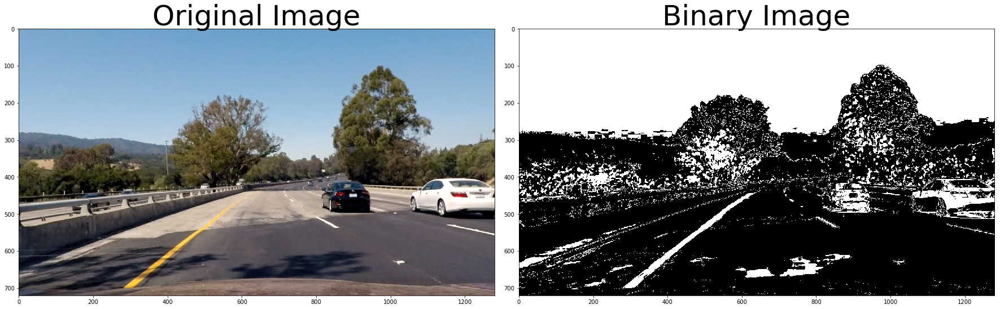

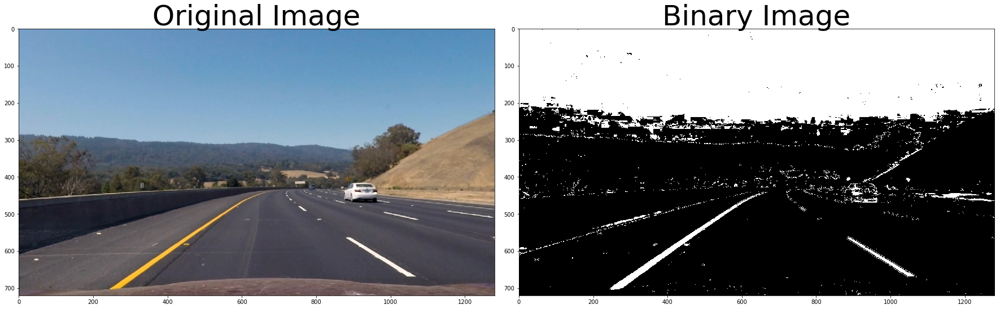

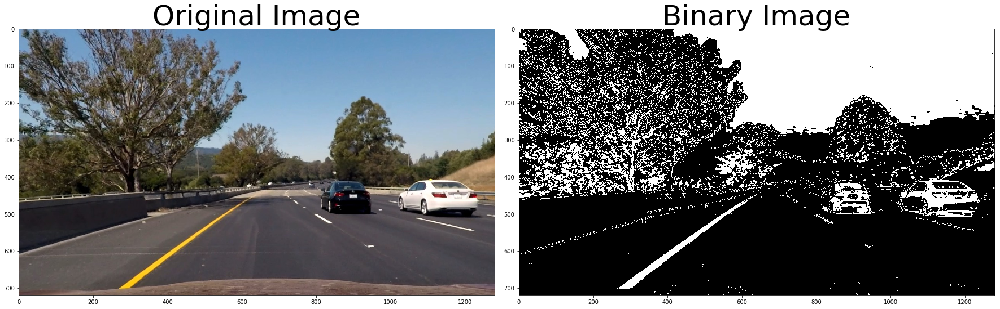

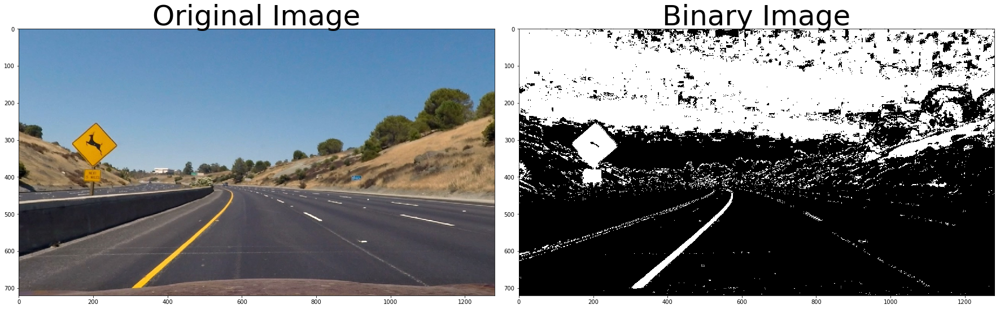

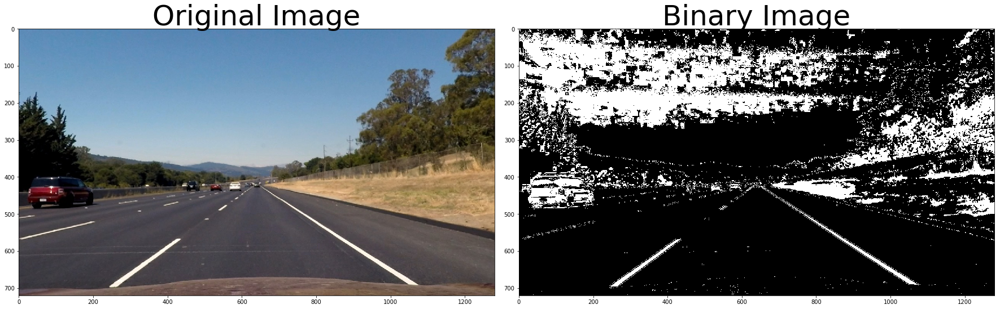

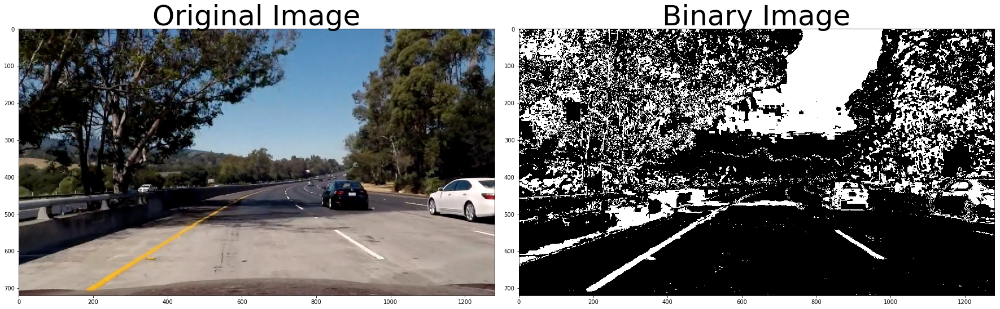

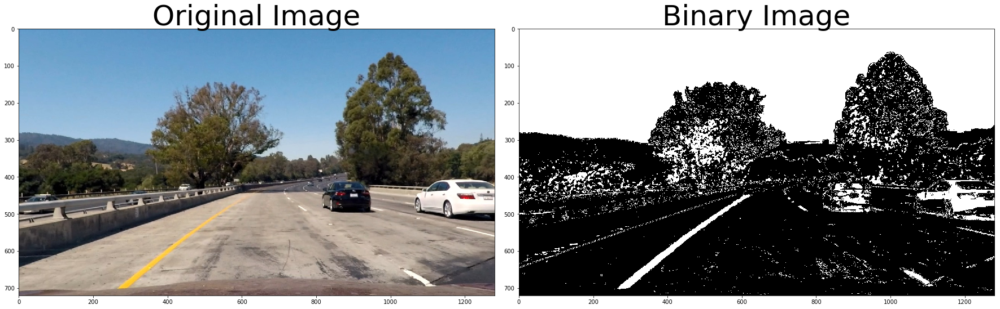

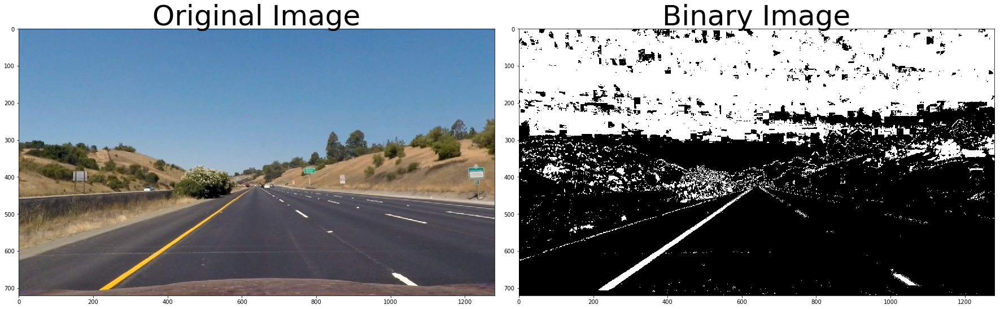

In [16]:
# Visualize additional filter combinations
kernel_size = 3
for image in test_images_undst:
    img = np.copy(image)
    s = apply_saturation_mask(image)
    dx = abs_sobel_thresh(img, 'x', kernel_size, (30, 100))
    dy = abs_sobel_thresh(img, 'y', kernel_size, (30, 100))
    mag = mag_thresh(img, kernel_size, (30, 100))
    direction = dir_threshold(img, kernel_size, (0.7, 1.3))
    comb = np.zeros_like(direction)    
    comb[((dx == 1) & (dy == 1)) | ((mag == 1) & (direction == 1) | (s == 1))] = 1
    #comb[(mag == 1) & (direction == 1) | (s == 1)] = 1
    
    show_images_sxs(image, comb, ['Original Image', 'Binary Image'], None, 'gray')

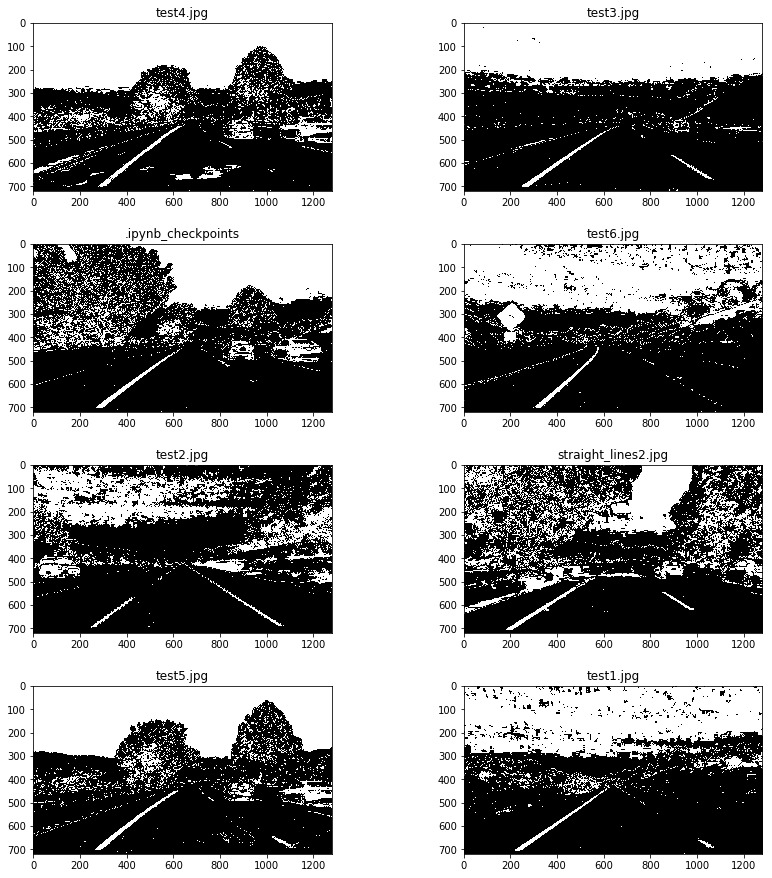

output_images/binary_filtered/test4-binary.jpg
output_images/binary_filtered/test3-binary.jpg
output_images/binary_filtered/.ipynb_checkpo-binary.jpg
output_images/binary_filtered/test6-binary.jpg
output_images/binary_filtered/test2-binary.jpg
output_images/binary_filtered/straight_lines2-binary.jpg
output_images/binary_filtered/test5-binary.jpg
output_images/binary_filtered/test1-binary.jpg


In [17]:
# Visualize saturation and gradient mask binary filtering
binary_test_images5 = [apply_saturation_and_gradient_masks(image) for image in test_images_undst]
show_images(binary_test_images5, titles, 'gray')
save_images(binary_test_images5, titles, 'binary', 'output_images/binary_filtered/')

## Create Image Perspective Transform

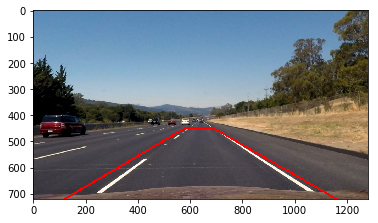

In [18]:
# Draw ROI on image to determine points to choose, then warp utilizing those lines. Start with straight road first.
def draw_ROI_lines(image):
    img = np.copy(image)
    (height, width) = img.shape [:2]
    vertices = [(120, height), (580, 450), (width-590, 450), (width-120, height)]

    cv2.line(img, vertices[0], vertices[1],(255,0,0), 5)
    cv2.line(img, vertices[1], vertices[2],(255,0,0), 5)
    cv2.line(img, vertices[2], vertices[3],(255,0,0), 5)
    
    plt.imshow(img)
    
draw_ROI_lines(test_images_undst[4])

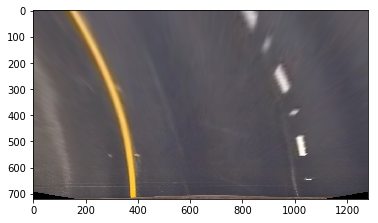

In [19]:
# Warp image - Perform Perspective Transform
def get_lane_perspective(image):
    img = np.copy(image)
    (height, width) = img.shape[:2]

    # Specify source points to transform
    top_left_corner = (588, 450)
    top_right_corner = (width-588, 450)
    bottom_right_corner = (width-120, height)
    bottom_left_corner = (120, height)
    src = np.float32([top_left_corner, top_right_corner, bottom_right_corner, bottom_left_corner])
    
    # Specify destination points to transform to
    dst_offset = width * 0.2
    dst = np.float32([[dst_offset,0], [width-dst_offset,0], [width-dst_offset, height], [dst_offset,height]])
    
    # Generate transformation matrices
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # Warp image to return
    warped = cv2.warpPerspective(img, M, (width, height), flags = cv2.INTER_LINEAR)

    return warped, M, Minv

# Visualize warped image
w, m, mInv = get_lane_perspective(test_images_undst[3])
plt.imshow(w)
#save_images([w], ['perspective_transform.jpg'], 'warped', 'output_images/warped_images/')

## Visualize Perspective Transform On Binary Images

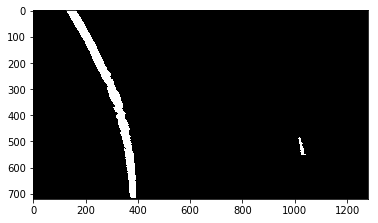

In [20]:
# Visualize perspective transform on saturation mask alone
plt.imshow(apply_saturation_mask(w), cmap='gray')

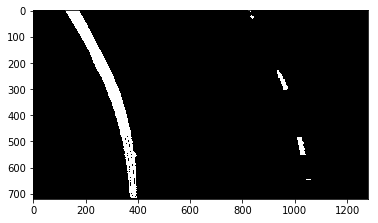

In [21]:
# Visualize perspective transform on mulitple colorspace masking
plt.imshow(select_lines_in_colorspaces(w), cmap='gray')

## Manually Tune Filter Hyperparameters

In [22]:
def apply_saturation_mask2(image_id, kernel_size, thresh_low, thresh_high):
    img = np.copy(test_images_undst[image_id])
    warp, m, mInv = get_lane_perspective(img)
    hls_img = select_lines_in_hls(warp)
    
    blur = cv2.GaussianBlur(hls_img, (kernel_size, kernel_size), 0)
    
    s = cv2.cvtColor(blur, cv2.COLOR_RGB2HLS)[:,:,2]
    
    thresh = (thresh_low, thresh_high)
    binary_output = np.zeros_like(s)
    binary_output[(s >= thresh[0]) & (s <= thresh[1])] = 1

    #sat_mask = apply_saturation_mask(hls_img)
    #sat_grad_mask = apply_saturation_and_gradient_masks(hls_img)
    
    plt.imshow(binary_output, cmap='gray')

interact(apply_saturation_mask2, image_id=(0,7,1), kernel_size=(1,9,2), thresh_low=(0,255,5), thresh_high=(0,255,5))

interactive(children=(IntSlider(value=3, description='image_id', max=7), IntSlider(value=5, description='kernel_size', max=9, min=1, step=2), IntSlider(value=125, description='thresh_low', max=255, step=5), IntSlider(value=125, description='thresh_high', max=255, step=5), Output()), _dom_classes=('widget-interact',))

<function __main__.apply_saturation_mask2(image_id, kernel_size, thresh_low, thresh_high)>

In [23]:
def apply_sat_and_grad_masks(img_id, ksize, dxl, dxh, dyl, dyh, magl, magh, dirl, dirh):
    img = np.copy(test_images_undst[img_id])
    warp, m, mInv = get_lane_perspective(img)
    
    kernel_size = ksize
    s = apply_saturation_mask(warp)
    dx = abs_sobel_thresh(warp, 'x', kernel_size, (dxl, dxh))#20,100
    dy = abs_sobel_thresh(warp, 'y', kernel_size, (dyl, dyh)) #20,100
    mag = mag_thresh(warp, kernel_size, (magl, magh)) #30,100
    print(dirl, dirh)
    direction = dir_threshold(img, kernel_size, (dirl, dirh)) #0.7, 1.3
    comb = np.zeros_like(direction)    
    comb[((dx == 1) & (dy == 1)) | ((mag == 1) & (direction == 1)) | (s == 1)] = 1
    plt.imshow(comb)
    
    # image 3
    # ksize = 7
    # dxl = 20
    # dxh = 100
    # dyl = 0
    # dyh = 100
    #magl = 135
    #magh = 160
    #dirl = 0.7
    #dirh = 1.3

interact(apply_sat_and_grad_masks, img_id=(0,7,1), ksize=(1,9,2), dxl=(0,255,5), dxh=(0,255,5), dyl=(0,255,5), magl=(0,255,5), magh=(0,255,5), dyh=(0,255,5), dirl=(0,2.0,0.1), dirh=(0,2.0,0.1)) 

interactive(children=(IntSlider(value=3, description='img_id', max=7), IntSlider(value=5, description='ksize', max=9, min=1, step=2), IntSlider(value=125, description='dxl', max=255, step=5), IntSlider(value=125, description='dxh', max=255, step=5), IntSlider(value=125, description='dyl', max=255, step=5), IntSlider(value=125, description='dyh', max=255, step=5), IntSlider(value=125, description='magl', max=255, step=5), IntSlider(value=125, description='magh', max=255, step=5), FloatSlider(value=1.0, description='dirl', max=2.0), FloatSlider(value=1.0, description='dirh', max=2.0), Output()), _dom_classes=('widget-interact',))

<function __main__.apply_sat_and_grad_masks(img_id, ksize, dxl, dxh, dyl, dyh, magl, magh, dirl, dirh)>

In [24]:
def apply_colorspace_masks(img_id, satl, sath, bl, bh, ll, lh):
    img = np.copy(test_images_undst[img_id])
    warp, m, mInv = get_lane_perspective(img)

    hls = cv2.cvtColor(warp, cv2.COLOR_RGB2HLS)
    lab = cv2.cvtColor(warp, cv2.COLOR_RGB2Luv)
    luv = cv2.cvtColor(warp, cv2.COLOR_RGB2Lab)
    
    s = hls[:,:,2]
    s_binary = np.zeros_like(s)
    s_binary[(s >= satl) & (s <= sath)] = 1
    
    b = lab[:,:,2]
    b_binary = np.zeros_like(b)
    b_binary[(b >= bl) & (b <= bh)] = 1
    
    l = luv[:,:,0]
    l_binary = np.zeros_like(l)
    l_binary[(l >= ll) & (l <= lh)] = 1
    
    binary_comb = np.zeros_like(s)
    binary_comb[((l_binary == 1) | (b_binary == 1)) & (s_binary == 1)] = 1
    
    plt.imshow(binary_comb, cmap='gray')

interact(apply_colorspace_masks, img_id=(0,7,1), satl=(0,255,5), sath=(0,255,5), bl=(0,255,5), bh=(0,255,5),  ll=(0,255,5), lh=(0,255,5)) 

interactive(children=(IntSlider(value=3, description='img_id', max=7), IntSlider(value=125, description='satl', max=255, step=5), IntSlider(value=125, description='sath', max=255, step=5), IntSlider(value=125, description='bl', max=255, step=5), IntSlider(value=125, description='bh', max=255, step=5), IntSlider(value=125, description='ll', max=255, step=5), IntSlider(value=125, description='lh', max=255, step=5), Output()), _dom_classes=('widget-interact',))

<function __main__.apply_colorspace_masks(img_id, satl, sath, bl, bh, ll, lh)>

## Detect Lane Lines and Fit Polynomials

In [25]:
def hist(img):
    height, width = img.shape
    histogram = np.sum(img[height*2//3:, :], axis=0)
    return histogram

def find_lane_pixels(warped_image):
    # Get histogram to determine starting position of each lane line
    histogram = hist(warped_image)
    
    # Create an output image for drawing and visualization
    out_img = np.dstack((warped_image, warped_image, warped_image))*255

    # Split the image vertically into left and right halves
    midpoint = np.int(histogram.shape[0]//2)
    
    # Find the location of each lane line from the bottom of the image
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:])+midpoint

    # Set up sliding windows and hyperparameters
    nWindows = 10
    margin = 75
    min_pix = 50

    # Establish window height
    window_height = np.int(warped_image.shape[0]//nWindows)

    # Determine the x and y-positions of all pixels in the image
    nonzero = warped_image.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Set current position
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create lists for left and right lane indices
    left_lane_inds = []
    right_lane_inds = []

    # Fit a polynomial to the lane lines
    # Step through the windows
    for window in range(nWindows):
        # Identify the horizontal boundaries for the windows
        win_y_low = warped_image.shape[0] - (window + 1) * window_height
        win_y_high = warped_image.shape[0] - window * window_height
        win_x_left_low = leftx_current - margin
        win_x_left_high = leftx_current + margin
        win_x_right_low = rightx_current - margin
        win_x_right_high = rightx_current + margin

        # Draw the rectangular windows on the image
        cv2.rectangle(out_img, (win_x_left_low, win_y_low), (win_x_left_high, win_y_high), (0,255,0), 2)
        cv2.rectangle(out_img, (win_x_right_low, win_y_low), (win_x_right_high, win_y_high), (0,255,0), 2)

        # Identify the nonzero pixels inside of the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                        (nonzerox >= win_x_left_low) & (nonzerox < win_x_left_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                         (nonzerox >= win_x_right_low) & (nonzerox < win_x_right_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        # If the quantity of pixels found is greater than min_pix, re-center the next window
        # based upon their mean position.
        if len(good_left_inds) > min_pix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))

        if len(good_right_inds) > min_pix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))


    # Concatenate the arrays of lane line indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right positions of the pixels in the lane lines
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img

def fit_polynomial(warped_image):
    # Get lane pixels
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(warped_image)
    plt.imshow(out_img)
    
    # Fit a second order polynomial to each lane line
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate coordinates for plotting
    ploty = np.linspace(0, warped_image.shape[0]-1, warped_image.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Generate output image
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
    plt.plot(left_fitx, ploty, color='yellow', lw=3)
    plt.plot(right_fitx, ploty, color='yellow', lw=3)
    
    return out_img, left_fit, right_fit, ploty

def fit_poly(img_shape, leftx, lefty, rightx, righty):
  
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    left_fit = None
    right_fit = None
    left_fitx = None
    right_fitx = None 
    
    # Fit a second order polynomial to each lane line and generate coordinates for plotting
    if len(leftx) > 0 and len(lefty) > 0:
        left_fit = np.polyfit(lefty, leftx, 2)
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    
    if len(rightx) > 0 and len(righty) > 0:
        right_fit = np.polyfit(righty, rightx, 2)
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fit, left_fitx, right_fit, right_fitx, ploty

def search_around_poly(warped_image):
    margin = 100
    
    # Determine the x and y-positions of all pixels in the image
    nonzero = warped_image.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(warped_image)
    
    # Fit new polynomials to the lane lines
    left_fit, left_fitx, right_fit, right_fitx, ploty = fit_poly(warped_image.shape, leftx, lefty, rightx, righty)
    
    # Determine the search area based upon the margin
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) &
                     (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) &
                      (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Create visualization
    out_img = np.dstack((warped_image, warped_image, warped_image))*255
    window_img = np.zeros_like(out_img)
    
    # Add color to lane line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255,0,0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0,0,255]
    
    # Generate a polygon to identify the search window area
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    
    # Draw the lane lines onto the image
    cv2.fillPoly(window_img, np.int_([left_line_pts]),(0,255,0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]),(0,255,0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    
    return result

def search_around_poly2(warped_image, prev_left_fit, prev_right_fit):
    '''
        This function can be used to look around the previously found polynomial within
        the specified margin parameter to determine if another lane line can be found.
        
        This can help speed up the lane finding processing time for videos.
    '''
    margin = 100
    
    # Determine the x and y-positions of all pixels in the image
    nonzero = warped_image.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
        
    # Determine the search area based upon the margin
    left_lane_inds = ((nonzerox > (prev_left_fit[0]*(nonzeroy**2) + prev_left_fit[1]*nonzeroy + prev_left_fit[2] - margin)) &
                     (nonzerox < (prev_left_fit[0]*(nonzeroy**2) + prev_left_fit[1]*nonzeroy + prev_left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (prev_right_fit[0]*(nonzeroy**2) + prev_right_fit[1]*nonzeroy + prev_right_fit[2] - margin)) &
                      (nonzerox < (prev_right_fit[0]*(nonzeroy**2) + prev_right_fit[1]*nonzeroy + prev_right_fit[2] + margin)))
    
    # Extract left and right positions of the pixels in the lane lines
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    return leftx, lefty, rightx, righty

## Visualize Polynomial Fitting

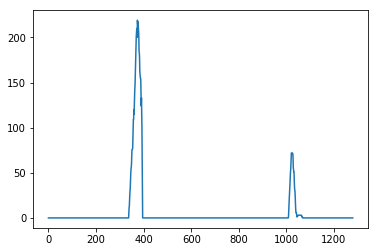

In [26]:
# Generate histogram for visualiztion of lane line detection
cspc_mask = select_lines_in_colorspaces(w)
histogram = hist(cspc_mask)
plt.plot(histogram)

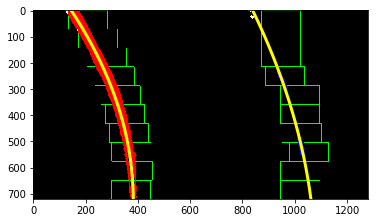

In [27]:
# Display visualization for sliding window search
test_img = test_images_undst[3]
warp_img, m, minv = get_lane_perspective(test_img)
c_mask = select_lines_in_colorspaces(warp_img)
out_img, lf, rf, ploty = fit_polynomial(c_mask)
plt.imshow(out_img)

#save_images([out_img], ['poly_line_fit.jpg'], 'sliding_windows', 'output_images/misc_images/')

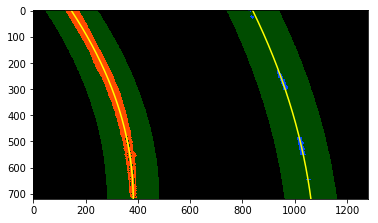

In [28]:
# Display visualization for margin around polynomial fit
c_res = search_around_poly(c_mask)
plt.imshow(c_res)
#plt.imsave('output_images/misc_images/search_around_poly.jpg', c_res)

## Calculate Lane Line Curvature and Offset, Then Draw Lane

In [29]:
#def measure_curvature_pixels(ploty, left_fit, right_fit):
def measure_curvature_pixels(ploty, leftx, rightx):
    '''
        Calculates the curvature of given polynomial functions in meters
    '''
    ym_per_pix = 30/720 # Meters per pixel in y-dimension
    xm_per_pix = 3.7/700 # Meters per pixel in x-dimension
    
    # Define the y-value at which the radius of curvature should be calculated. This will be the bottom of the image.
    y_eval = np.max(ploty)
    
    # Calculate the radius of curvature for each lane line
    left_curve_rad = None
    right_curve_rad = None
    
    # Fit a second order polynomial to pixel positions in each fake lane line
    left_fit_m = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    
    if left_fit_m is not None:
        left_curve_rad = (((1 + (2*left_fit_m[0]*y_eval*ym_per_pix + left_fit_m[1])**2)**(3/2))/np.abs(2*left_fit_m[0]))
        
    if right_fit_m is not None:
        right_curve_rad = (((1 + (2*right_fit_m[0]*y_eval*ym_per_pix + right_fit_m[1])**2)**(3/2))/np.abs(2*right_fit_m[0]))
    
    return left_curve_rad, right_curve_rad

def measure_curvature_pixels_and_lane_offset(img_shape, ploty, leftx, rightx, lf, rf):
    '''
        Calculates the curvature of given polynomial functions in meters and calculates
         the distance between the centerline of the vehicle and the center of the lane.
        This assumes that the camera center is coincident with the centerline of the vehicle.
    '''
    height, width = img_shape[:2]
    y_eval = height
    left_location = (lf[0]*y_eval**2 + lf[1]*y_eval + lf[2])
    right_location = (rf[0]*y_eval**2 + rf[1]*y_eval + rf[2])
    
    ym_per_pix = 30/720 # Meters per pixel in y-dimension
    xm_per_pix = 3.7/(right_location-left_location) # Meters per pixel in x-dimension
    
    # Calculate lane center offset from image center
    lane_center_location = (left_location + right_location) / 2
    lane_offset = lane_center_location - width / 2    
    lane_offset_m = lane_offset * xm_per_pix # Lane offset in meters
    
    # Calculate the radius of curvature for each lane line
    left_curve_rad = None
    right_curve_rad = None
    
    # Fit a second order polynomial to pixel positions in each fake lane line
    left_fit_m = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    
    if left_fit_m is not None:
        left_curve_rad = (((1 + (2*left_fit_m[0]*y_eval*ym_per_pix + left_fit_m[1])**2)**(3/2))/np.abs(2*left_fit_m[0]))
        
    if right_fit_m is not None:
        right_curve_rad = (((1 + (2*right_fit_m[0]*y_eval*ym_per_pix + right_fit_m[1])**2)**(3/2))/np.abs(2*right_fit_m[0]))
    
    return left_curve_rad, right_curve_rad, lane_offset_m

In [30]:
def draw_lane(prev_image, warped_image, left_fit, right_fit, minv):
    img = np.copy(prev_image)
    
    if left_fit is None or right_fit is None:
        return img
    
    # Create an image to draw lane lines on
    warped_zero = np.zeros_like(warped_image).astype(np.uint8)
    color_warp = np.dstack((warped_zero, warped_zero, warped_zero))
    
    height, width = warped_image.shape[:2]
    ploty = np.linspace(0, height-1, height)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]    
    
    left_px = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_px = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pix = np.hstack((left_px, right_px))
    
    # Draw the lane back onto the warped image
    cv2.fillPoly(color_warp, np.int_([pix]), (0,255,0))
    cv2.polylines(color_warp, np.int32([left_px]), isClosed=False, color=(255,0,0), thickness=40)
    cv2.polylines(color_warp, np.int32([right_px]), isClosed=False, color=(0,0,255), thickness=40)
    
    # Unwarp the warped image
    unwarped_img = cv2.warpPerspective(color_warp, minv, (width, height))
    
    # Overlay the drawn lane onto the original image
    return cv2.addWeighted(img, 1, unwarped_img, 0.5, 0)    

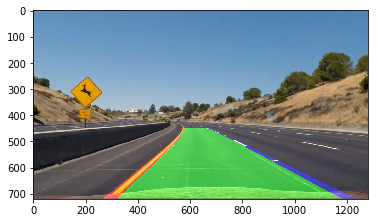

In [31]:
# Display image with lane drawn
lane_image = draw_lane(test_img, c_mask, lf, rf, mInv)
plt.imshow(lane_image)

In [32]:
def draw_curve_radius_info(image, curve_rad, lane_center_dist):
    img = np.copy(image)
    height = img.shape[0]    
    font = cv2.FONT_HERSHEY_TRIPLEX
    
    radius_text = 'Radius of curvature: '
    # Generate radius of curvature text
    if curve_rad < 1000:        
        radius_text += '{:-4.2f}'.format(curve_rad) + 'm'
    else:
        radius_text += '{:-4.2f}'.format(curve_rad/1000) + 'km'
    
    # Generate lane center location text
    dist_from_center = '{:-4.3f}'.format(abs(lane_center_dist)) + 'm '
    loc_from_center = ''
    if lane_center_dist < 0:
        loc_from_center = dist_from_center + 'right of center'
    elif lane_center_dist > 0:
        loc_from_center = dist_from_center + 'left of center'
    else:
        loc_from_center = 'On center'
    
    location_text = 'Vehicle location: ' + loc_from_center
    
    # Add text to image    
    cv2.putText(img, radius_text, (50, 50), font, 1.5, (200, 255, 200), 2, cv2.LINE_AA)
    cv2.putText(img, location_text, (50, 100), font, 1.5, (200, 255, 200), 2, cv2.LINE_AA)
    return img

output_images/misc_images/lane_image-drawn.jpg


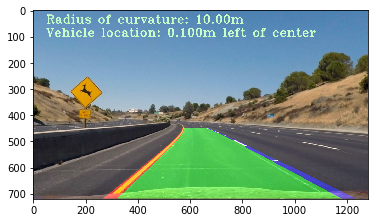

In [33]:
# Display visualization of image with lane drawn and curve radius/offset information printed
img_w_info = draw_curve_radius_info(lane_image, 10, 0.10)
plt.imshow(img_w_info)

save_images([img_w_info], ['lane_image.jpg'], 'drawn', 'output_images/misc_images/')

# Lane Finding Pipeline

In [34]:
# Create a class to store information about lane line instances
class Line():
    def __init__(self):
        # Set a boolean value to true of a line was detected in the last iteration
        self.detected = False
        
        # Create an array to store the last nFits of lane lines for averaging
        self.nFits = 5
        self.recent_fits = []
        self.recent_x_values = []        
        
        # Average polynomial coefficients over the last nFits iterations
        # This will return three elements [y**2, y, b]
        self.best_fit = None
        
        # Average the x values over the the last nFits iterations
        # This will return an average across each array for the corresponding y-value
        self.bestx = None
        
        # Polynomial coefficients for current fit
        self.current_fit = [np.array([False])]
        
        # Curvature of the turn radius in meters
        self.radius_of_curvature = 0
        
        # Distance in meters of vehicle center from the lane line
        self.line_base_pos = 0
        
        # Store the difference between fit coefficients between the current and last fit
        # This will be used to threshold bad lines
        self.diffs = np.array([0,0,0], dtype='float')
        
        # x-values for detected line pixels
        self.allx = None
        
        # y-values for detected line pixels
        self.ally = None
        
    def add_current_fit(self, fit, xvals, lane_offset, roc):
        if fit is not None:
            if self.best_fit is not None:
                if self.__validate_current_fit(fit):
                    self.__insert_fit(fit, xvals, lane_offset, roc)
                    if len(self.recent_fits) > self.nFits:
                        self.__drop_oldest_fit()
                else:
                    # This is a bad fit as the thresholds have been exceeded, do not keep
                    self.detected = False                    
            else:
                # The best fit has not been established. Update with this fit.
                if len(self.recent_fits) > 0:
                    self.drop_oldest_fit()
                    
                if len(self.recent_fits) == 0:
                    # Take this as the first fit
                    self.__insert_fit(fit, xvals, lane_offset, roc)
        else:
            self.detected = False

        
    def __calculate_best_fit(self):
        if len(self.recent_fits) > 0:
            self.best_fit = np.average(self.recent_fits, axis=0)
            self.bestx = np.average(self.recent_x_values, axis=0)
        else:
            self.best_fit = None
            self.bestx = None
        
    def __drop_oldest_fit(self):
        if len(self.recent_fits) > 0:
            self.recent_fits = self.recent_fits[1:]
            self.recent_x_values = self.recent_x_values[1:]
        
        # Recalculate best fit with fewer fits
        if len(self.recent_fits) > 0:
            self.__calculate_best_fit()
        
    def __insert_fit(self, fit, xvals, lane_offset, roc):
        self.detected = True
        self.line_base_pos = lane_offset
        self.radius_of_curvature = roc
        self.recent_x_values.append(xvals)
        self.recent_fits.append(fit)
        self.__calculate_best_fit()
        
    def __validate_current_fit(self, new_fit):
        # Thresholds must be set high enough that the vehicle can turn
        self.diffs = np.abs(new_fit - self.best_fit)
        if self.diffs[0] > 0.01 or self.diffs[1] > 1.0 or self.diffs[2] > 100.0:
            return False
        return True    
        
    def get_best_fit(self):
        self.__calculate_best_fit()
        return self.best_fit
    
    def get_last_fit(self):
        if len(self.recent_fits) > 0:
            return self.recent_fits[-1]
        else:
            return None
                
    def get_curve_radius(self):
        return self.radius_of_curvature
    
    def reset(self):
        '''
        Clear all instance variables
        '''
        self.detected = False
        self.nFits = 5
        self.recent_fits = []
        self.recent_x_values = []        
        self.best_fit = None
        self.bestx = None
        self.current_fit = [np.array([False])]
        self.radius_of_curvature = 0
        self.line_base_pos = 0
        self.diffs = np.array([0,0,0], dtype='float')
        self.allx = None
        self.ally = None

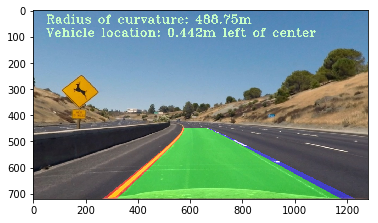

In [35]:
def find_lane(image):    
    img = np.copy(image)
    
    #Undistort image
    undist_img = undistort_image(img, mtx, dist)
    
    # Apply various filters to obtain lane lines from image
    masked_img = select_lines_in_colorspaces(undist_img)
    
    # Get lane perspective
    warped_image, M, Minv = get_lane_perspective(masked_img)
    
    if left_lane_line.detected and right_lane_line.detected:
        # Use the search around poly function here
        leftx, lefty, rightx, righty = search_around_poly2(warped_image, left_lane_line.get_last_fit(), right_lane_line.get_last_fit())
    else:            
        # Get lane line pixels via sliding window search
        leftx, lefty, rightx, righty, out_img = find_lane_pixels(warped_image)

    if len(leftx) > 0 and len(lefty) > 0 and len(rightx) > 0 and len(righty) > 0:    
        # Fit polynomial lines to lanes
        left_fit, left_fitx, right_fit, right_fitx, ploty = fit_poly(warped_image.shape, leftx, lefty, rightx, righty)

        # Get curve radius and lane offset from lane lines
        left_curve_rad, right_curve_rad, lane_center_offset = measure_curvature_pixels_and_lane_offset(warped_image.shape, ploty, left_fitx, right_fitx, left_fit, right_fit)


        # Add current fit to Line class for each lane line
        left_lane_line.add_current_fit(left_fit, left_fitx, lane_center_offset, left_curve_rad)
        right_lane_line.add_current_fit(right_fit, right_fitx, lane_center_offset, right_curve_rad)
    
    # Calculate average curve radius for the two lane lines
    curve_rad_avg = np.mean([left_lane_line.get_curve_radius(), right_lane_line.get_curve_radius()])
    
    # Get vehicle center offset from lane center
    lane_center_offset = left_lane_line.line_base_pos
    
    # Draw the best_fit (averaged) lane lines onto the image
    weighted_img = draw_lane(undist_img, warped_image, left_lane_line.get_best_fit(), right_lane_line.get_best_fit(), Minv)

    # Return the image with the radius of curvature and vehicle location information displayed
    return draw_curve_radius_info(weighted_img, curve_rad_avg, lane_center_offset)

left_lane_line = Line()
right_lane_line = Line()
lane_img = find_lane(test_images_undst[3])
plt.imshow(lane_img)
#plt.imsave("output_images/misc_images/lane_location_info.jpg", lane_img)

## Test Pipeline on Videos

In [36]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [ ]:
left_lane_line = Line()
right_lane_line = Line()

project_vid_output = "output_videos/project_video.mp4"
#clip1 = VideoFileClip("project_video.mp4").subclip(0,10)
#clip1 = VideoFileClip("project_video.mp4").subclip(39,48)
clip1 = VideoFileClip("project_video.mp4")
project_vid_clip = clip1.fl_image(find_lane)
%time project_vid_clip.write_videofile(project_vid_output, audio=False)

[MoviePy] >>>> Building video output_videos/project_video.mp4
[MoviePy] Writing video output_videos/project_video.mp4


 45%|████▍     | 567/1261 [02:22<03:05,  3.74it/s]

In [ ]:
HTML("""
<video width="960" height="540" controls>
    <source src="{0}">
</video>
""".format(project_vid_output))

# Challenge Video

In [ ]:
left_lane_line = Line()
right_lane_line = Line()

challenge_vid_output = "output_videos/challenge_video.mp4"
#clip2 = VideoFileClip("challenge_video.mp4").subclip(0,1)
clip2 = VideoFileClip("challenge_video.mp4")
challenge_vid_clip = clip2.fl_image(find_lane)
%time challenge_vid_clip.write_videofile(challenge_vid_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
    <source src="{0}">
</video>
""".format(challenge_vid_output))